In [ ]:
from googletrans import Translator

In [ ]:
!pip install googletrans==4.0.0-rc1

In [ ]:
pip install opencv-python

In [ ]:
pip install tesseract

In [ ]:
pip install pytesseract

In [ ]:
import cv2
from PIL import Image
import pytesseract

In [ ]:
from PIL import Image

im_file = "/content/Rental-Agreement-Format.jpg"

im = Image.open(im_file)
im.save("/content/test.png")
im.show()

In [ ]:
import cv2
from matplotlib import pyplot as plt
image_file = "/content/test.png"
img = cv2.imread(image_file)

In [ ]:
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]

    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

In [ ]:
display(image_file)

 Inverted Images

In [ ]:
inverted_image = cv2.bitwise_not(img)
cv2.imwrite("/content/inverted.png", inverted_image)

True

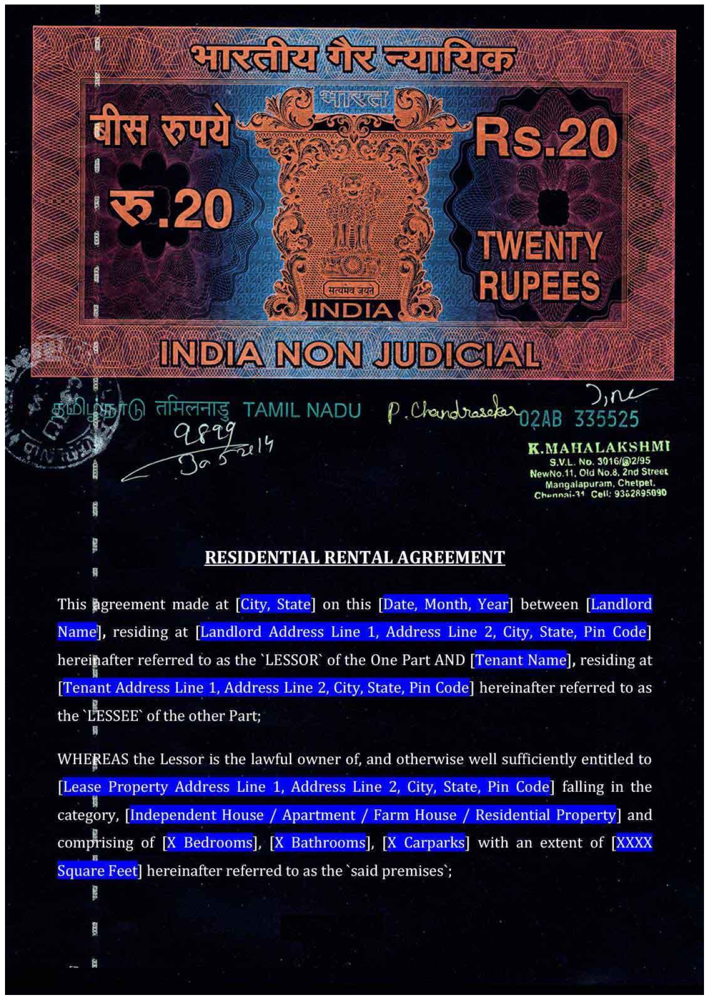

In [ ]:
display("/content/inverted.png")


In [ ]:
####### Binarization

def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [ ]:
gray_image = grayscale(img)
cv2.imwrite("/content/gray.png", gray_image)

True

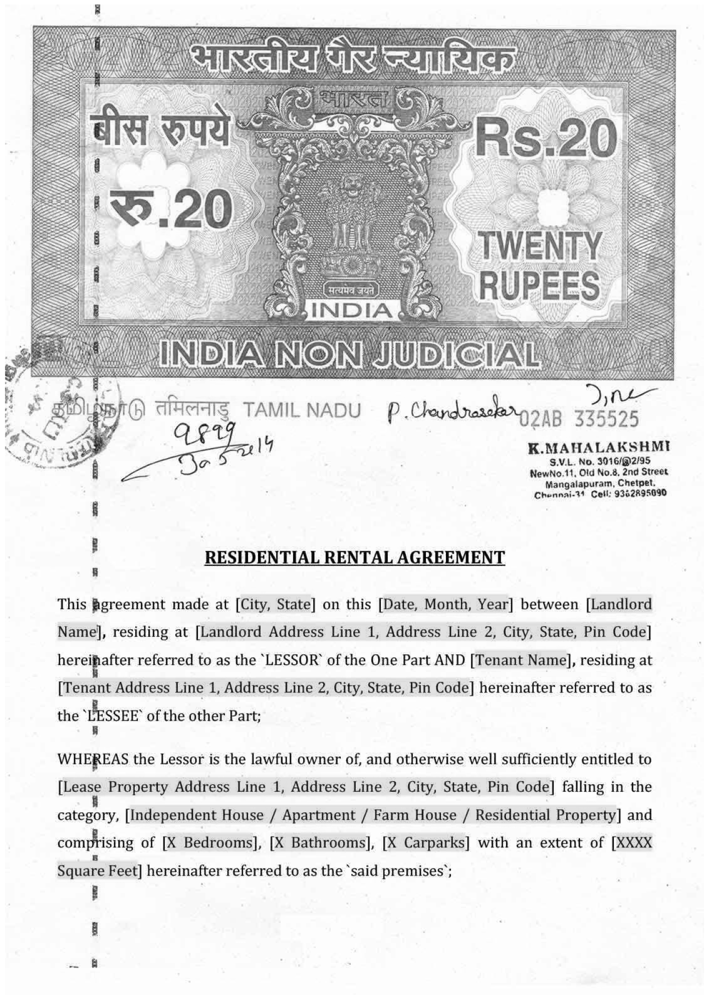

In [ ]:
display("/content/gray.png")


In [ ]:
thresh, im_bw = cv2.threshold(gray_image, 200, 230, cv2.THRESH_BINARY)
cv2.imwrite("/content/bw_image.png", im_bw)

True

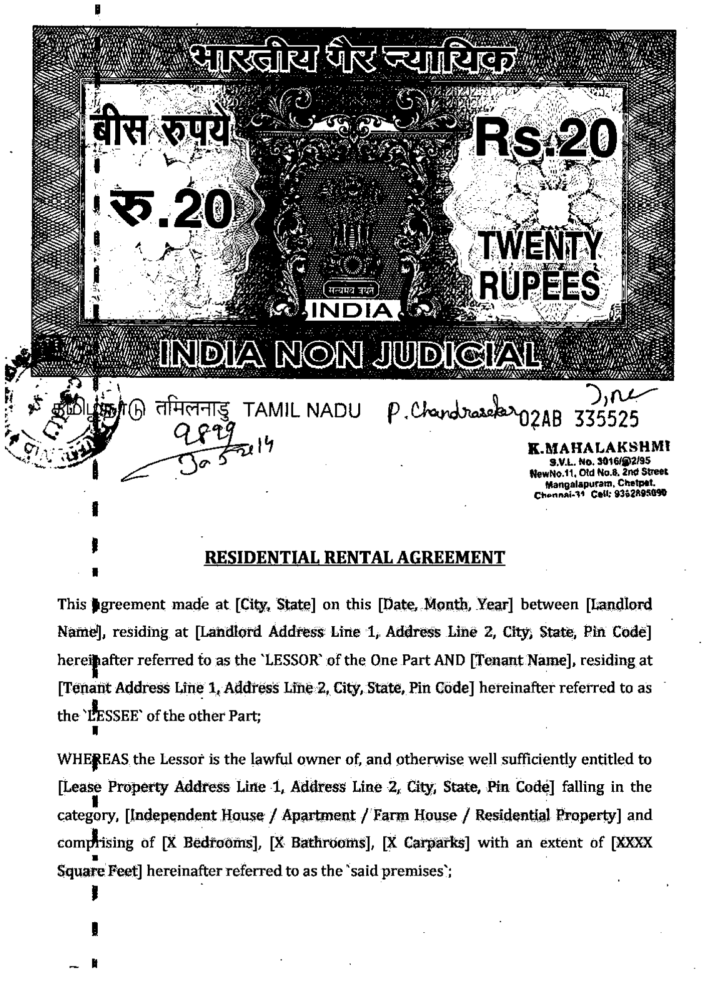

In [ ]:
display("/content/bw_image.png")

Noise Removal

In [ ]:
def noise_removal2(image):
    import numpy as np
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return (image)

In [ ]:
import cv2
import numpy as np

def noise_removal(image):
    if len(image.shape) > 2:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray_image = image

    _, binary_mask = cv2.threshold(gray_image, 200, 255, cv2.THRESH_BINARY_INV)

    kernel = np.ones((3, 3), np.uint8)
    opened_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel, iterations=2)

    closed_mask = cv2.morphologyEx(opened_mask, cv2.MORPH_CLOSE, kernel, iterations=2)

    cleaned_background = cv2.bitwise_and(gray_image, gray_image, mask=closed_mask)

    cleaned_image = cv2.bitwise_and(gray_image, gray_image, mask=~closed_mask)

    final_image = cv2.add(cleaned_background, cleaned_image)

    return final_image


In [ ]:
no_noise = noise_removal2(im_bw)
cv2.imwrite("/content/no_noise.png", no_noise)



True

In [ ]:
no_noise = noise_removal(im_bw)
cv2.imwrite("/content/no_noise.png", no_noise)

True

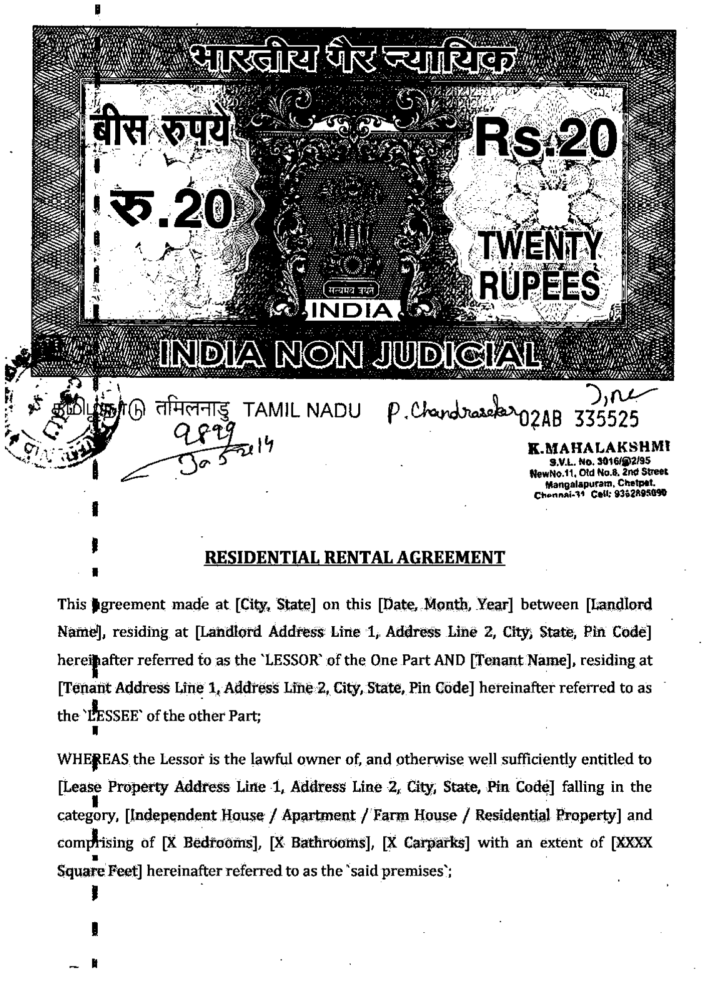

In [ ]:
display("/content/no_noise.png")


Dilation and Erosion

In [ ]:
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [ ]:
eroded_image = thin_font(no_noise)
cv2.imwrite("/content/eroded_image.jpg", eroded_image)

True

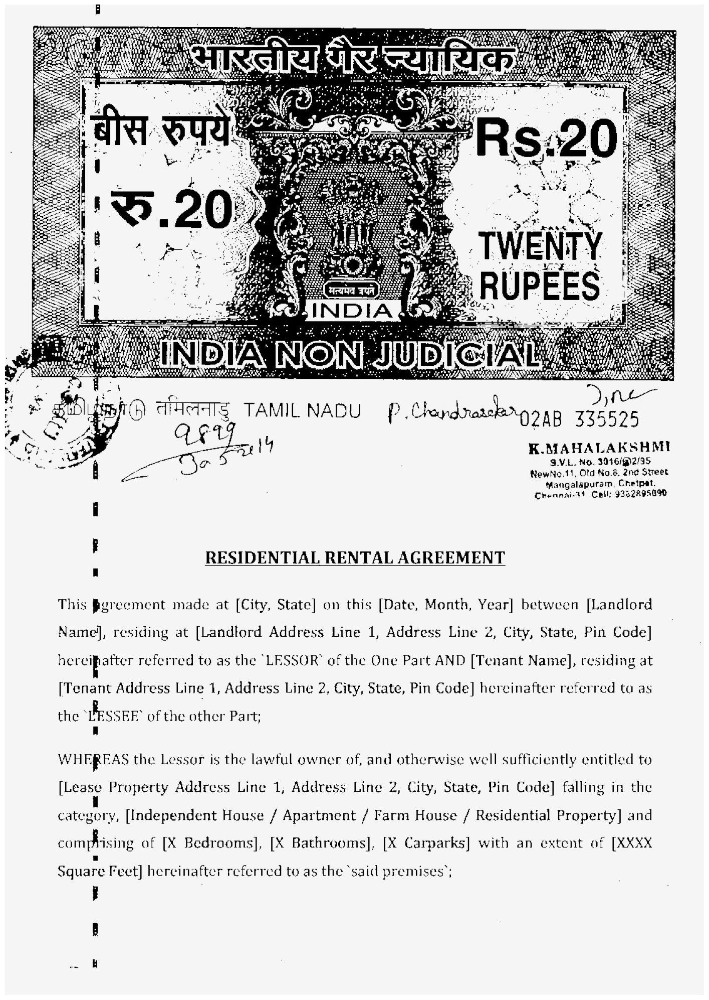

In [ ]:
display("/content/eroded_image.jpg")

In [ ]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [ ]:
dilated_image = thick_font(no_noise)
cv2.imwrite("/content/dilated_image.jpg", dilated_image)

True

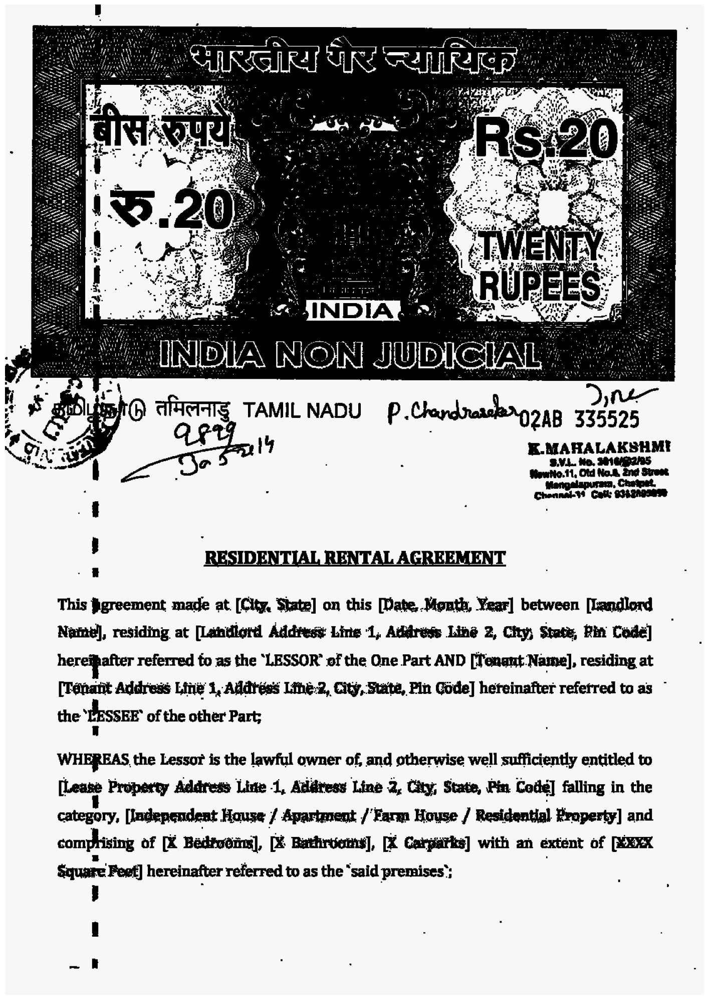

In [ ]:
display("/content/dilated_image.jpg")

 Rotation / Deskewing

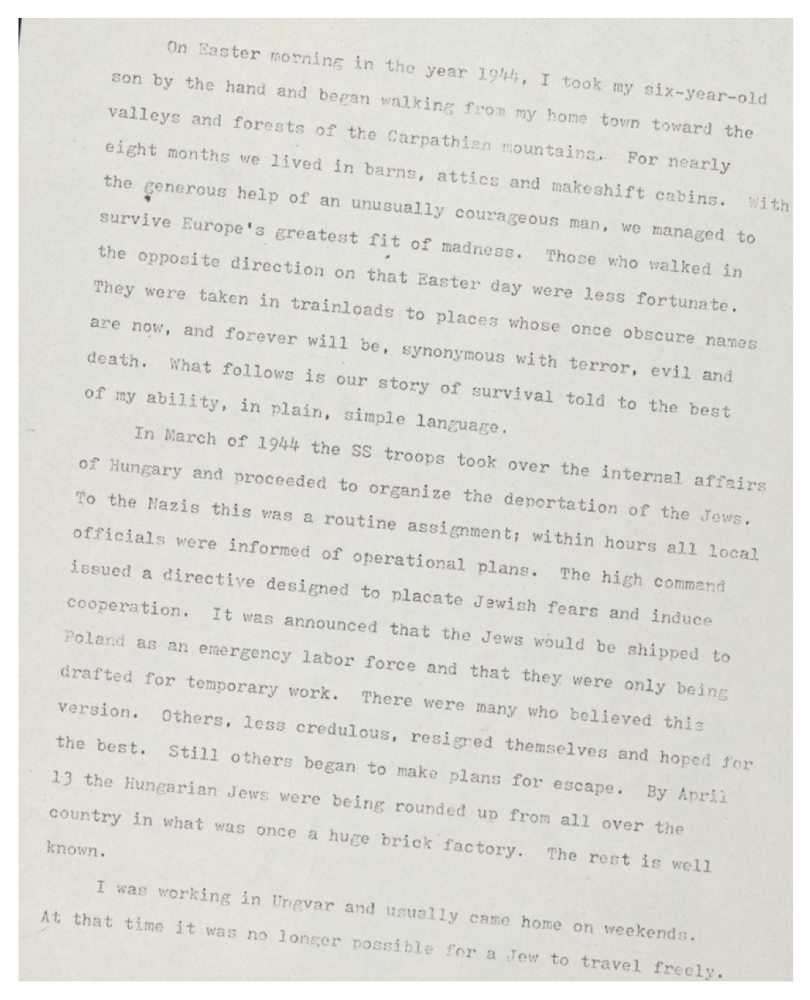

In [ ]:
new = cv2.imread("/content/skewed image.png")
display("/content/skewed image.png")

In [ ]:
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("/content/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [ ]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [ ]:
fixed = deskew(new)
cv2.imwrite("/content/rotated_fixed.jpg", fixed)

28


True

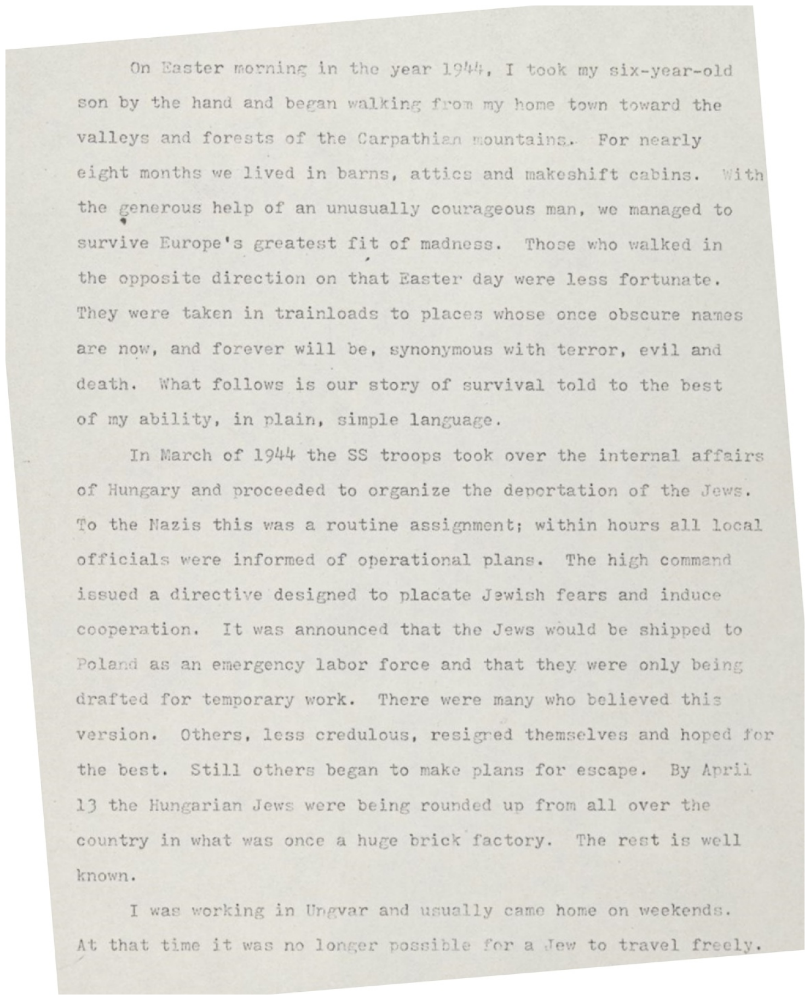

In [ ]:
display("/content/rotated_fixed.jpg")

Removing Borders

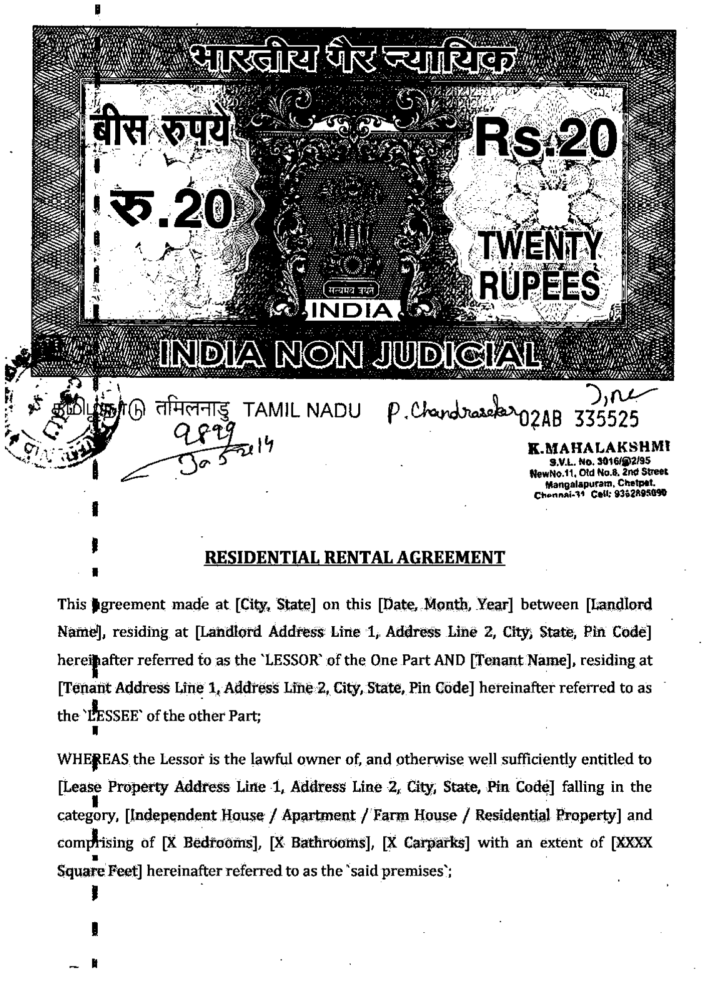

In [ ]:
display("/content/no_noise.png")

In [ ]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

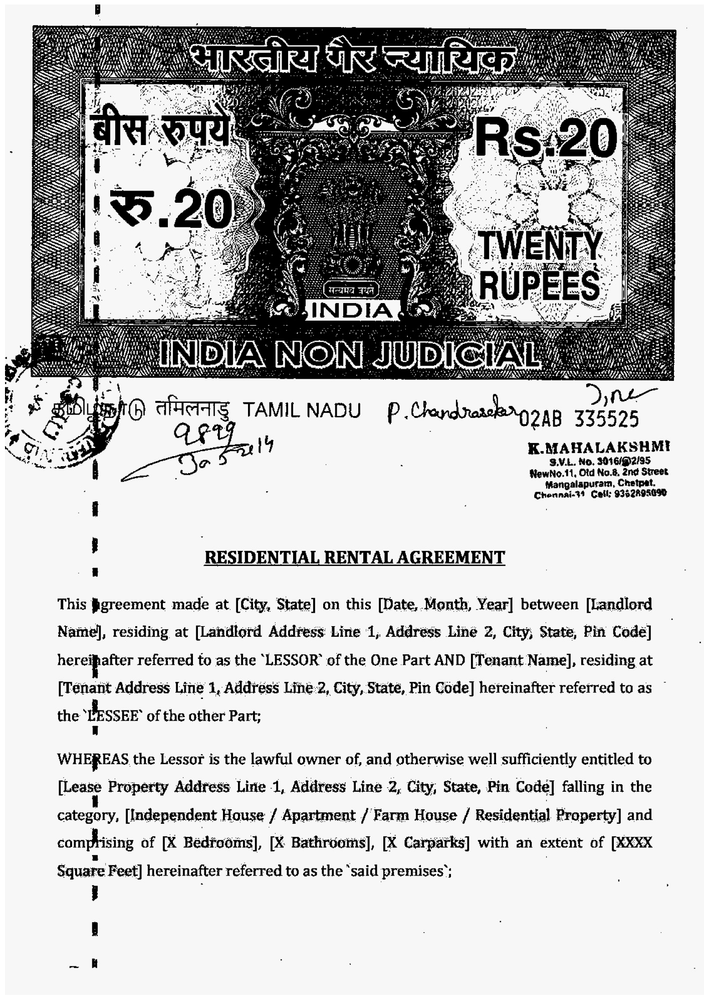

In [ ]:
no_borders = remove_borders(no_noise)
cv2.imwrite("/content/no_borders.jpg", no_borders)
display('/content/no_borders.jpg')

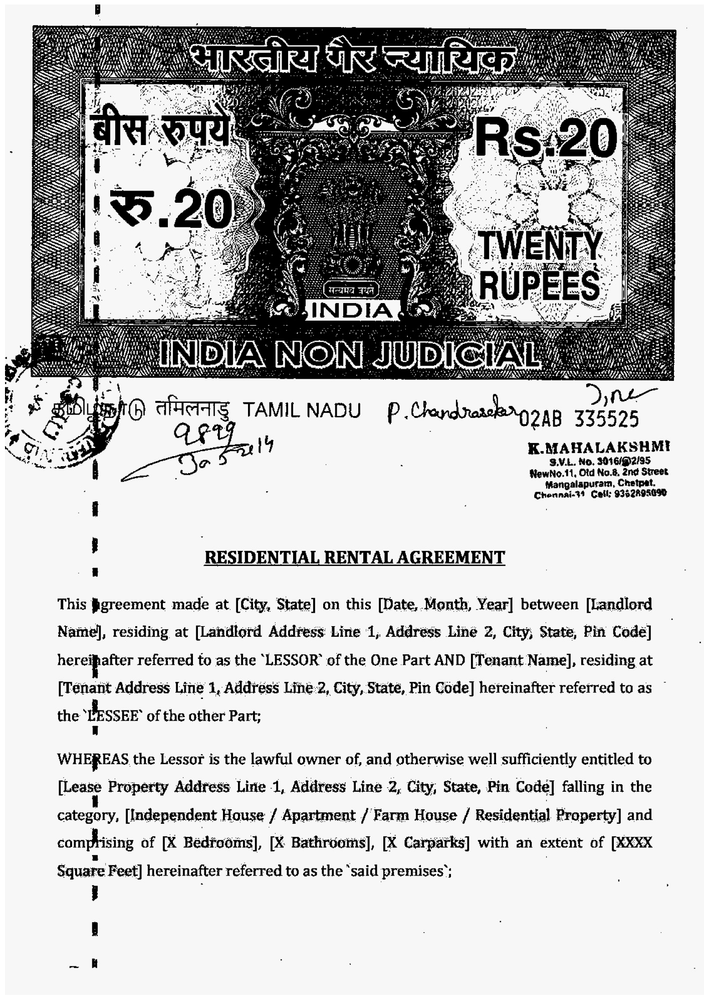

In [ ]:
no_borders = remove_borders(no_noise)
cv2.imwrite("/content/no_borders.jpg", no_borders)
display('/content/no_borders.jpg')

ADDING BORDER

In [ ]:
color = [255,255,255]
top , bottom , left , right = [150]*4

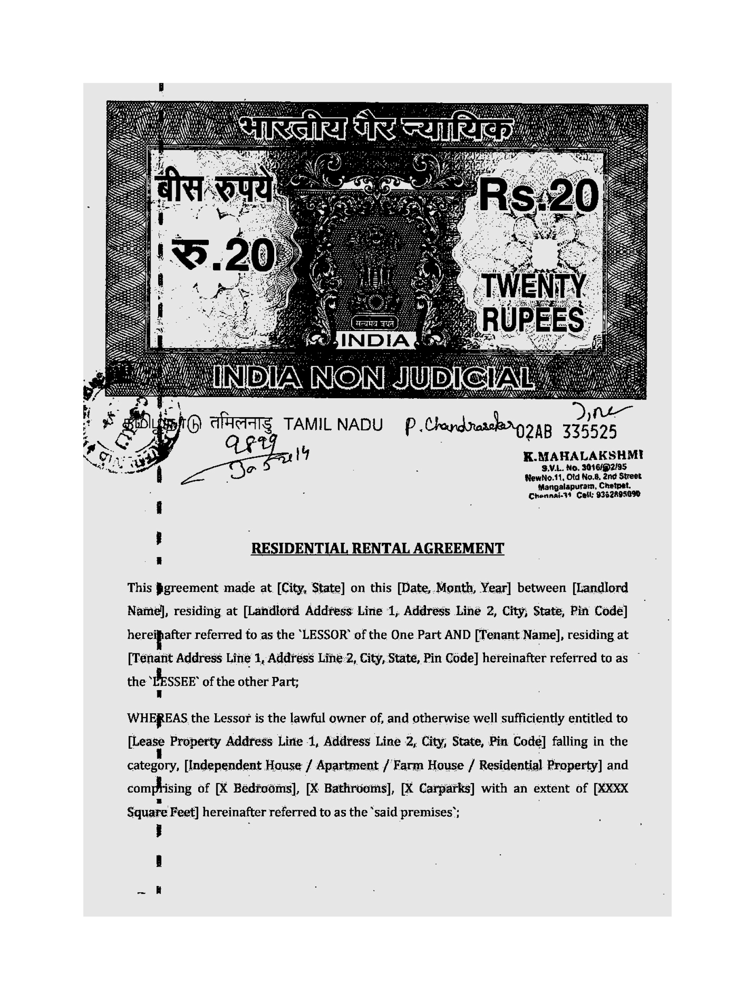

In [ ]:
image_with_border = cv2.copyMakeBorder(no_borders,top , bottom , left , right ,cv2.BORDER_CONSTANT , value = color)
cv2.imwrite("/content/image_with_border.jpg" ,image_with_border )
display("/content/image_with_border.jpg")

In [ ]:
# pip install pytesseract

In [ ]:
# import pytesseract
# from PIL import Image

In [ ]:

# img_file = "/content/download.png"
# no_noise = "/content/no_noise.jpg"

In [ ]:
# img = Image.open(no_noise)
# display(img)

In [ ]:
!sudo apt-get install tesseract-ocr


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 38 not upgraded.


In [ ]:
!pip install pytesseract


In [ ]:
import pytesseract
from pytesseract import Output
pytesseract.pytesseract.tesseract_cmd = '/usr/bin/tesseract'


In [ ]:
from PIL import Image
import pytesseract
from PIL import Image


img_file = "/content/download.png"
no_noise = "/content/image_with_border.jpg"






In [ ]:
ocr_result = pytesseract.image_to_string(no_noise)

print(ocr_result)

  

LS

)) ne

 
  

CU Qe TAMIL NADU P .Chordnarslar O2AB 335525
: 14 K.MAHALAKSHME
io 5 SVL. No. 3046/02/95

 

tWangalapuramn, Chetpat,

  

i-39 Call: 932298090

RESIDENTIAL RENTAL AGREEMENT

This [greement made at [City, State] on this [Date,.Month, Year] between [Landlord
Name], residing at [Landlord Address: Line 1, Address Liné 2, City, State, Pin Codé]
Dea referred to as the ‘LESSOR’ of the One Part AND [Tenant Name], residing at
[Tenarit Address Line 1, Address Line:2, City, State, Pin Code] hereinafter referred to as ©
the ‘tesse of the other Part;

WHEREAS the Lessor is the lawful owner of, and otherwise well sufficiently entitled to
[Lease Property Address Line 1, Address Line 2, City, State, Pin Code] falling in the
category, [Independent House / Apartment /'Farm House / Residential. Property] and
comphising of [X Bedfeoms], [X Bathrooms], [X Carparks] with an extent of [KXXX
Square Feet] hereinafter referred to as the ‘said premises;



In [ ]:
ocr_result = pytesseract.image_to_string("/content/Rental-Agreement-Format.jpg")

print(ocr_result)

   

0 —
TAMIL NADU P.Chardreselorgong 339525

\4 K.MAHALAKSHME
: S.V.L. No. 3016/@)2/95
NewNo.11, Old No.8, 2nd Street
Mangalapuram, Chetpet.
Chennai-%4 Cell: 9362898090

   

Qer

 

RESIDENTIAL RENTAL AGREEMENT

This Agreement made at [City, State] on this [Date, Month, Year] between [Landlord
Namel, residing at [Landlord Address Line 1, Address Line 2, City, State, Pin Code]

hereifiafter referred to as the ‘LESSOR’ of the One Part AND [Tenant Name], residing at

hereinafter referred to as

the ‘Gasser of the other Part;
i

WHEREAS the Lessor is the lawful owner of, and otherwise well sufficiently entitled to
[Lease Property Address Line 1, Address Line 2, City, State, Pin Code} fling inthe
category, [Independent House / Apartment / Farm House / Residential Property] and
comprising of [X Bedrooms], [X Bathrooms], [X Carparks] with an extent of [XXXX
SqUEeeEE) hereinafter referred to as the ‘said premises’;

5



In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments, AutoTokenizer, AutoModel, BartForConditionalGeneration, BertLMHeadModel, pipeline

tokenizer = AutoTokenizer.from_pretrained("nlpaueb/legal-bert-base-uncased")

model = BertLMHeadModel.from_pretrained("nlpaueb/legal-bert-base-uncased")

def generate_text(input_text, max_length=500):
    inputs = tokenizer.encode(input_text, return_tensors="pt")
    outputs = model.generate(inputs, max_length=max_length, do_sample=True, top_k=50, top_p=0.95, num_return_sequences=1)
    generated_text = tokenizer.decode(outputs[0], skip_special_tokens=True)

    return generated_text

summarizer = pipeline("summarization", model="facebook/bart-large-cnn")

ARTICLE=input()
print(summarizer(ARTICLE, max_length=130, min_length=30, do_sample=False))
Bert_out = summarizer(ARTICLE, max_length=130, min_length=30, do_sample=False)

If you want to use `BertLMHeadModel` as a standalone, add `is_decoder=True.`


This agreement made at [City, State] on this [Date,.Month, Year] between [Landlord Name], residing at [Landlord Address: Line 1, Address Liné 2, City, State, Pin Codé] Dea referred to as the ‘LESSOR’ of the One Part AND [Tenant Name], residing at [Tenarit Address Line 1, Address Line:2, City, State, Pin Code] hereinafter referred to as © the ‘tesse of the other Part;  WHEREAS the Lessor is the lawful owner of, and otherwise well sufficiently entitled to [Lease Property Address Line 1, Address Line 2, City, State, Pin Code] falling in the category, [Independent House / Apartment /'Farm House / Residential. Property] and comphising of [X Bedfeoms], [X Bathrooms], [X Carparks] with an extent of [KXXX Square Feet] hereinafter referred to as the ‘said premises; 
[{'summary_text': 'This agreement made at [City, State] on this [Date,.Month, Year] between [Landlord Name] and [Tenant Name], residing at [Tenarit Address Line 1, Address Line:2, City, State, Pin Code] hereinafter referred to as ©

In [ ]:


translator = Translator()

english_text = str(Bert_out[0]).strip('{}')

translated = translator.translate(english_text, src='en', dest='hi')
print("Hindi Translation: ",translated.text)

translated_marathi = translator.translate(english_text, src='en', dest='mr')
print("Marathi Translation: ", translated_marathi.text)

translated_bengali = translator.translate(english_text, src='en', dest='bn')
print("Bengali Translation: ", translated_bengali.text)